In [3]:
import numpy as np
import matplotlib.pyplot as plt
import math
import matplotlib.image as mpimg
import glob
import json
import os
import torch
import torch.nn as nn
import torch
from torch.autograd import Variable
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, sampler
import pandas as pd
import copy
from tqdm import tqdm
from joblib import Parallel, delayed
import subprocess

import sys
import os

import glob
import numpy as np
import matplotlib.pyplot as plt
from scipy import misc
import os
from tqdm import tqdm
from PIL import Image

import numpy

from numpy import (amin, amax, ravel, asarray, arange, ones, newaxis,
                   transpose, iscomplexobj, uint8, issubdtype, array)



['ISIC_0000015_semantic_input_label.jpg', 'ISIC_0000015_semantic_synthesized_image.jpg', 'ISIC_0000015.png']
['ISIC_0000025_semantic_input_label.jpg', 'ISIC_0000025_semantic_synthesized_image.jpg', 'ISIC_0000025.png']
['ISIC_0000031_semantic_input_label.jpg', 'ISIC_0000031_semantic_synthesized_image.jpg', 'ISIC_0000031.png']
['ISIC_0000037_semantic_input_label.jpg', 'ISIC_0000037_semantic_synthesized_image.jpg', 'ISIC_0000037.png']
['ISIC_0000057_semantic_input_label.jpg', 'ISIC_0000057_semantic_synthesized_image.jpg', 'ISIC_0000057.png']
['ISIC_0000075_semantic_input_label.jpg', 'ISIC_0000075_semantic_synthesized_image.jpg', 'ISIC_0000075.png']
['ISIC_0000101_semantic_input_label.jpg', 'ISIC_0000101_semantic_synthesized_image.jpg', 'ISIC_0000101.png']
['ISIC_0000116_semantic_input_label.jpg', 'ISIC_0000116_semantic_synthesized_image.jpg', 'ISIC_0000116.png']
['ISIC_0000121_semantic_input_label.jpg', 'ISIC_0000121_semantic_synthesized_image.jpg', 'ISIC_0000121.png']
['ISIC_0000129_sema

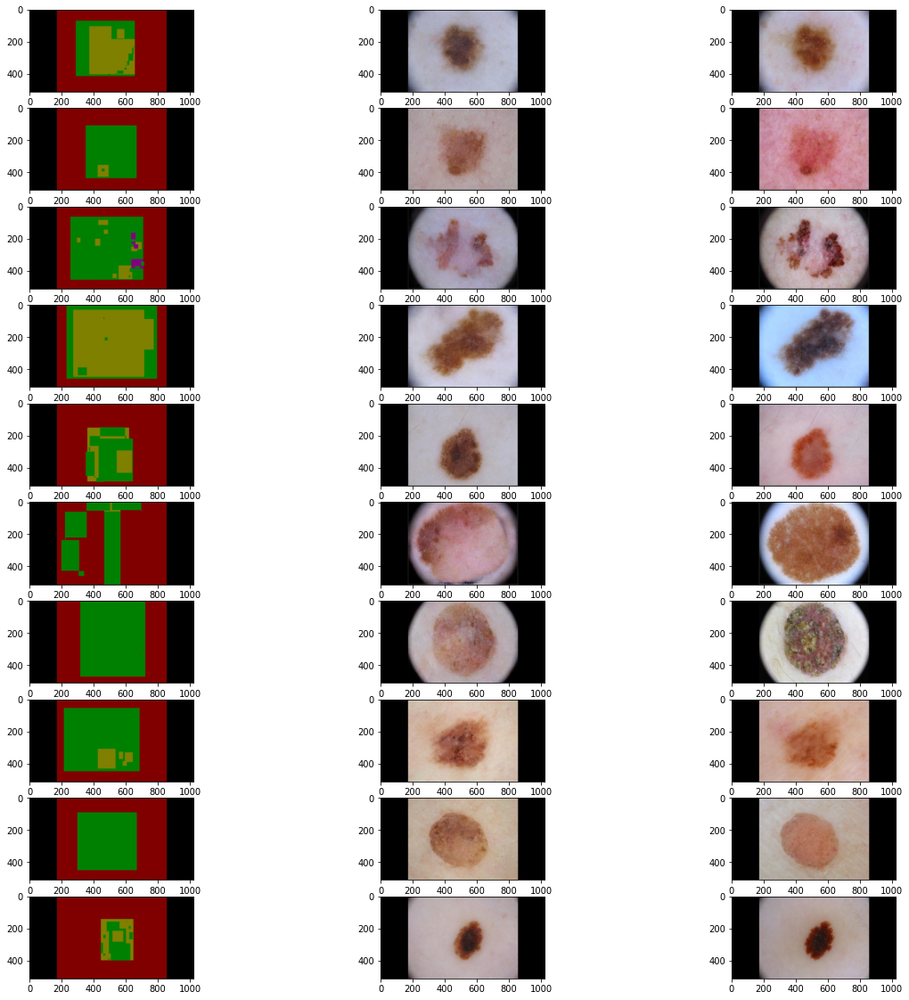

In [3]:
dir = "/mnt/tank/scratch/nduginets/images/pix2pix_result/test_on_250_only/label2skin/test_latest/images"
dir_t = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_datasets/test_img"
res = sorted(glob.glob(os.path.join(dir, "*.jpg")))
res_t = sorted(glob.glob(os.path.join(dir_t, "*.png")))

cnt = 10
fig, plots = plt.subplots(nrows=cnt, ncols=3, figsize = (20,20))

for i in range(cnt):
    plots[i][0].imshow(mpimg.imread(res[i * 2]))
    plots[i][1].imshow(mpimg.imread(res[i * 2 + 1]))
    plots[i][2].imshow(mpimg.imread(res_t[i]))
    
    l = list(map(lambda x: x.split("/")[-1], [res[i * 2], res[i * 2 + 1], res_t[i]]))
    print(l)
    
plt.show()




# Pretrained network G has fewer layers; The following are not initialized:
# ['model']


['ISIC_0000015_semantic_input_label.jpg', 'ISIC_0000015_semantic_synthesized_image.jpg', 'ISIC_0000015.png']
['ISIC_0000025_semantic_input_label.jpg', 'ISIC_0000025_semantic_synthesized_image.jpg', 'ISIC_0000025.png']
['ISIC_0000031_semantic_input_label.jpg', 'ISIC_0000031_semantic_synthesized_image.jpg', 'ISIC_0000031.png']
['ISIC_0000037_semantic_input_label.jpg', 'ISIC_0000037_semantic_synthesized_image.jpg', 'ISIC_0000037.png']
['ISIC_0000057_semantic_input_label.jpg', 'ISIC_0000057_semantic_synthesized_image.jpg', 'ISIC_0000057.png']
['ISIC_0000075_semantic_input_label.jpg', 'ISIC_0000075_semantic_synthesized_image.jpg', 'ISIC_0000075.png']
['ISIC_0000101_semantic_input_label.jpg', 'ISIC_0000101_semantic_synthesized_image.jpg', 'ISIC_0000101.png']
['ISIC_0000116_semantic_input_label.jpg', 'ISIC_0000116_semantic_synthesized_image.jpg', 'ISIC_0000116.png']
['ISIC_0000121_semantic_input_label.jpg', 'ISIC_0000121_semantic_synthesized_image.jpg', 'ISIC_0000121.png']
['ISIC_0000129_sema

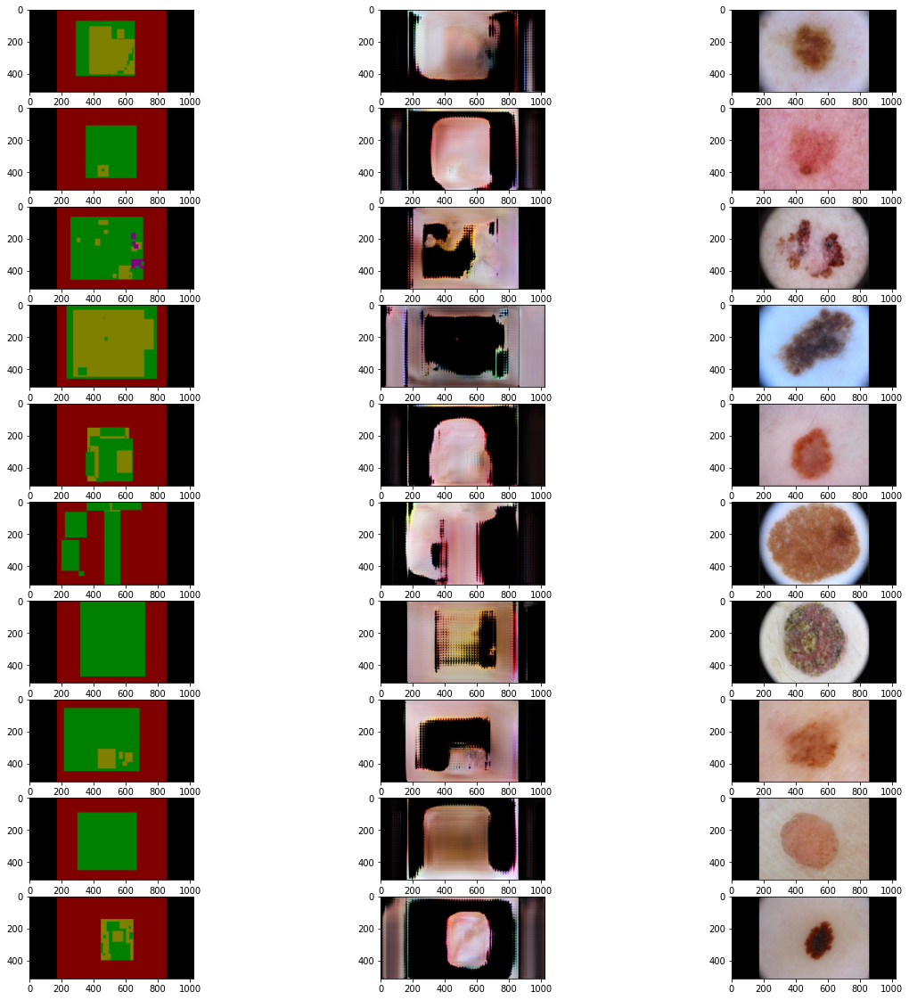

In [4]:
dir = "/mnt/tank/scratch/nduginets/images/pix2pix_result/test_on_250_only_no_inst/label2skin/test_latest/images"
dir_t = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_datasets/test_img"
res = sorted(glob.glob(os.path.join(dir, "*.jpg")))
res_t = sorted(glob.glob(os.path.join(dir_t, "*.png")))

cnt = 10
fig, plots = plt.subplots(nrows=cnt, ncols=3, figsize = (20,20))

for i in range(cnt):
    plots[i][0].imshow(mpimg.imread(res[i * 2]))
    plots[i][1].imshow(mpimg.imread(res[i * 2 + 1]))
    plots[i][2].imshow(mpimg.imread(res_t[i]))
    
    l = list(map(lambda x: x.split("/")[-1], [res[i * 2], res[i * 2 + 1], res_t[i]]))
    print(l)
    
plt.show()



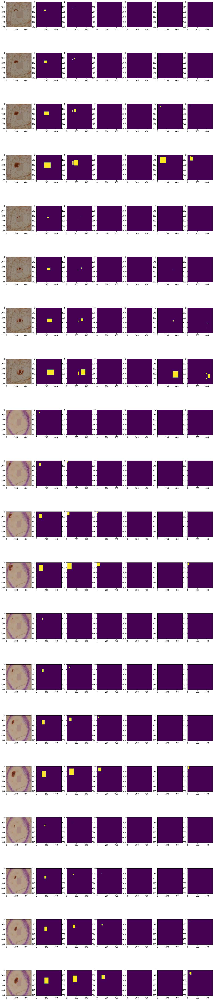

['/mnt/tank/scratch/nduginets/images/noise_bboxes/images/ISIC_9991000_image.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/segmentation/ISIC_9991000_segmentation.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes/ISIC_9991000_attribute_globules.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes/ISIC_9991000_attribute_milia_like_cyst.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes/ISIC_9991000_attribute_negative_network.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes/ISIC_9991000_attribute_pigment_network.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes/ISIC_9991000_attribute_streaks.png']


In [5]:
i_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes/images"
a_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes/attributes"
s_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes/segmentation"


i_l = sorted(glob.glob(os.path.join(i_d, "*.png")))
a_l = sorted(glob.glob(os.path.join(a_d, "*.png")))
s_l = sorted(glob.glob(os.path.join(s_d, "*.png")))


joined = []
for i in range(len(i_l)):
    p = [i_l[i], s_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)

cnt = 20
fig, plots = plt.subplots(nrows=cnt, ncols=7, figsize = (20,100))

for i in range(cnt):
    for j in range(7):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()


print(joined[0])

image segmentation mask globules milia like cyst negative network pigmentnetwork streaks


"\nfor i in range(cnt):\n    for j in range(7):\n        if i == 0:\n            plots[i][j].title.set_text(titles[j])\n        plots[i][j].axis('off')\n        plots[i][j].imshow(mpimg.imread(joined[i][j]))\nplt.show()\n\n\nprint(joined[0])"

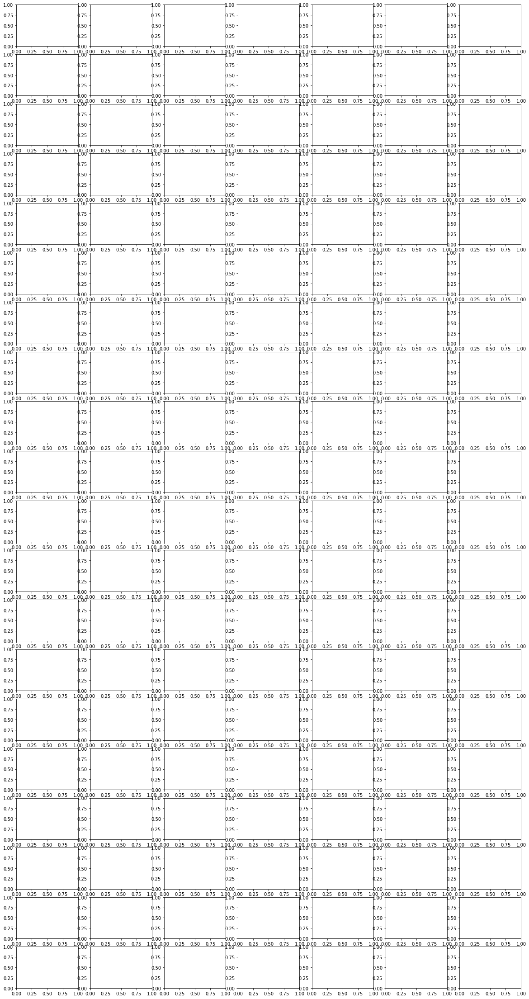

In [17]:
i_d = "/mnt/tank/scratch/nduginets/images/ISIC2018_Task1-2_Training_Input"
a_d = "/mnt/tank/scratch/nduginets/images/ISIC2018_Task2_Training_GroundTruth_v3"
s_d = "/mnt/tank/scratch/nduginets/images/ISIC2018_Task1_Training_GroundTruth"


i_l = sorted(glob.glob(os.path.join(i_d, "*.jpg")))
a_l = sorted(glob.glob(os.path.join(a_d, "*.png")))
s_l = sorted(glob.glob(os.path.join(s_d, "*.png")))


joined = []
for i in range(len(i_l)):
    p = [i_l[i], s_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)

cnt = 20
fig, plots = plt.subplots(nrows=cnt, ncols=7, figsize = (20,40))
titles = ["image", "segmentation mask", "globules", "milia like cyst", "negative network", "pigmentnetwork", "streaks"]

print(" ".join(titles))
"""
for i in range(cnt):
    for j in range(7):
        if i == 0:
            plots[i][j].title.set_text(titles[j])
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()


print(joined[0])"""

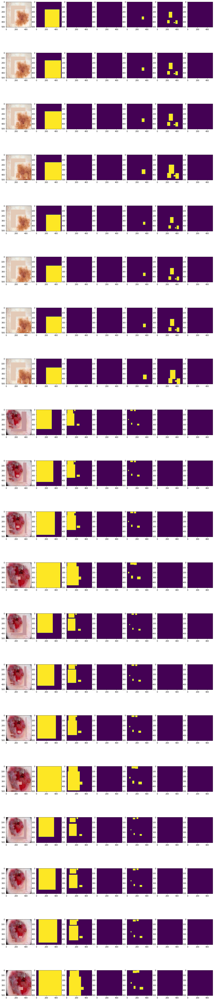

['/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/images/ISIC_9991000_image.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/segmentation/ISIC_9991000_segmentation.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes/ISIC_9991000_attribute_globules.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes/ISIC_9991000_attribute_milia_like_cyst.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes/ISIC_9991000_attribute_negative_network.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes/ISIC_9991000_attribute_pigment_network.png', '/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes/ISIC_9991000_attribute_streaks.png']


In [5]:
i_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/images"
a_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/attributes"
s_d = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/segmentation"


i_l = sorted(glob.glob(os.path.join(i_d, "*.png")))
a_l = sorted(glob.glob(os.path.join(a_d, "*.png")))
s_l = sorted(glob.glob(os.path.join(s_d, "*.png")))


joined = []
for i in range(len(i_l)):
    p = [i_l[i], s_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)

cnt = 20
fig, plots = plt.subplots(nrows=cnt, ncols=7, figsize = (20,100))

for i in range(cnt):
    for j in range(7):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()


print(joined[0])

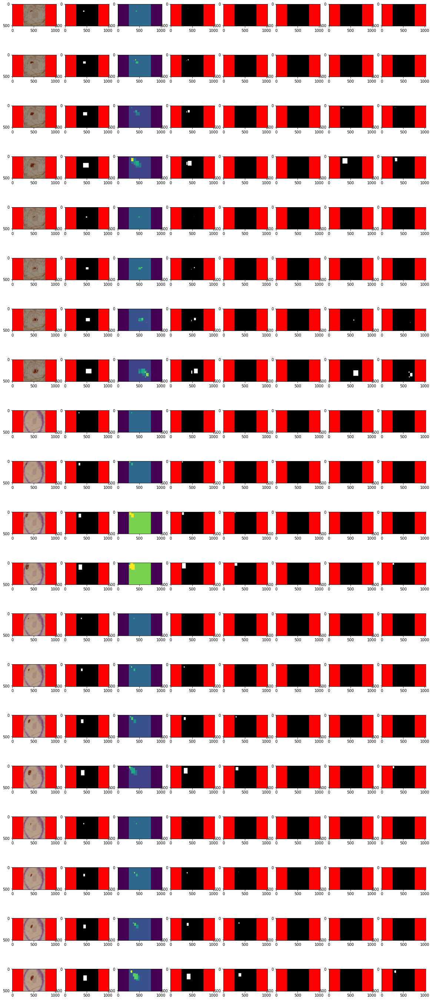

In [6]:
BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes/pix2pix"

SEGMENTATION_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "segmentation_resized")
ATTRIBUTES_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "attribute_resized")
IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "image_resized")
SEMANTIC_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "semantic_map")




i_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
a_l = sorted(glob.glob(os.path.join(ATTRIBUTES_RESIZED_PATH, "*.png")))
s_l = sorted(glob.glob(os.path.join(SEGMENTATION_RESIZED_PATH, "*.png")))
m_l = sorted(glob.glob(os.path.join(SEMANTIC_MAP_PATH, "*.png")))


joined = []
for i in range(len(i_l)):
    p = [i_l[i], s_l[i], m_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)

cnt = 20
fig, plots = plt.subplots(nrows=cnt, ncols=8, figsize = (20,50))

for i in range(cnt):
    for j in range(8):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()


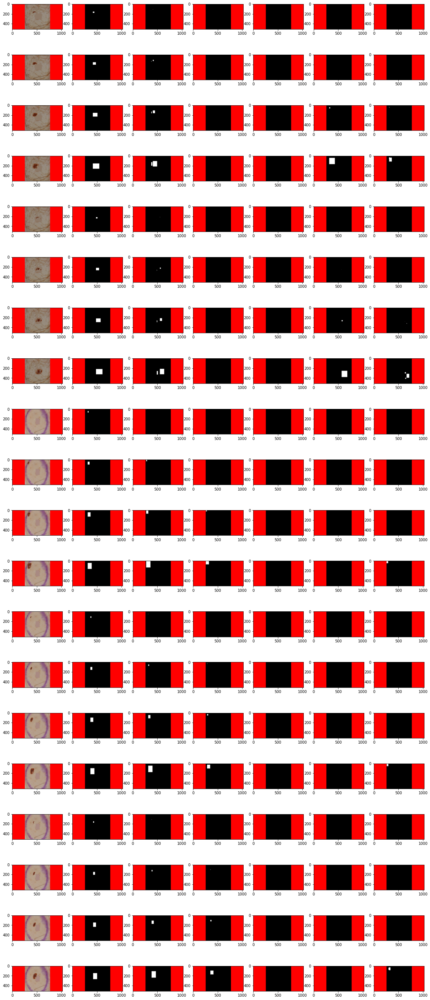

In [7]:
BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes/pix2pix"

SEGMENTATION_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "seg_512p")
ATTRIBUTES_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "attribute_512p")
IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")

i_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
a_l = sorted(glob.glob(os.path.join(ATTRIBUTES_RESIZED_PATH, "*.png")))
s_l = sorted(glob.glob(os.path.join(SEGMENTATION_RESIZED_PATH, "*.png")))


joined = []
for i in range(len(i_l)):
    p = [i_l[i], s_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)

cnt = 20
cols = 7
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (20,50))

for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()



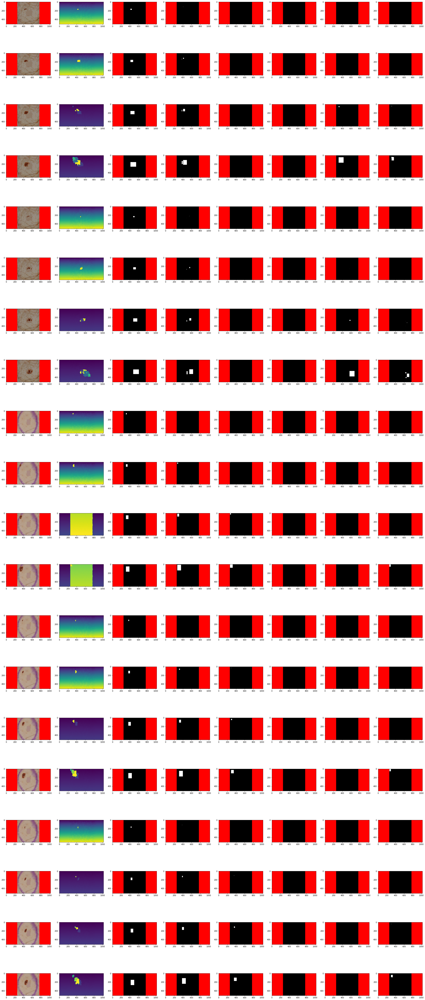

In [8]:
BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes/pix2pix"

SEGMENTATION_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "seg_512p")
ATTRIBUTES_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "attribute_512p")
IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")
MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map_no_border")


i_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
a_l = sorted(glob.glob(os.path.join(ATTRIBUTES_RESIZED_PATH, "*.png")))
s_l = sorted(glob.glob(os.path.join(SEGMENTATION_RESIZED_PATH, "*.png")))
m_l = sorted(glob.glob(os.path.join(MAP_PATH, "*.png")))

joined = []
for i in range(len(i_l)):
    p = [i_l[i], m_l[i], s_l[i]] + a_l[i * 5: (i + 1) * 5]
    joined.append(p)
    

cnt = 20
cols = 8
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (40,100))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()




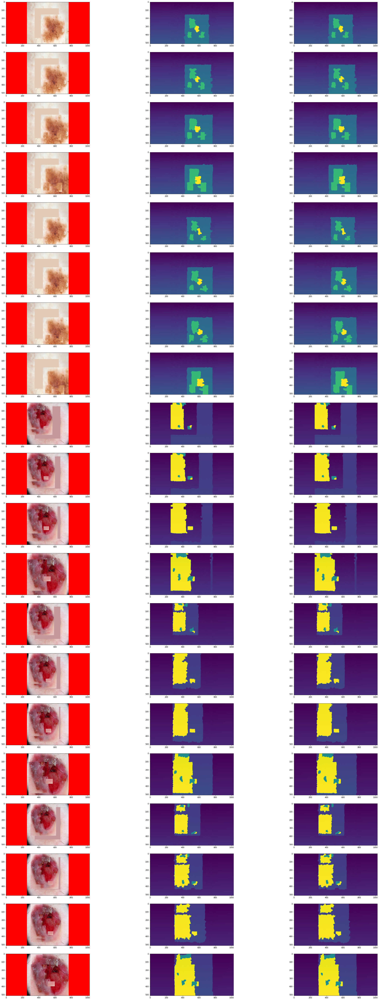

In [6]:
BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/pix2pix"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")
I_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map")
MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map_no_border")



i_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
m_l = sorted(glob.glob(os.path.join(I_MAP_PATH, "*.png")))
i_m_l = sorted(glob.glob(os.path.join(MAP_PATH, "*.png")))

joined = []
for i in range(len(i_l)):
    p = [i_l[i], m_l[i], i_m_l[i]]
    joined.append(p)
    

cnt = 20
cols = 3
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (40,100))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

#### 1
nduginets@turing:/mnt/tank/scratch/nduginets/images/noise_bboxes/pix2pix$ cp ./semantic_map/* /mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_dataset_based_on_noise/test_label/

## 2
nduginets@turing:/mnt/tank/scratch/nduginets/images/noise_bboxes/pix2pix$ cp ./instance_map/* /mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_dataset_based_on_noise/test_inst/


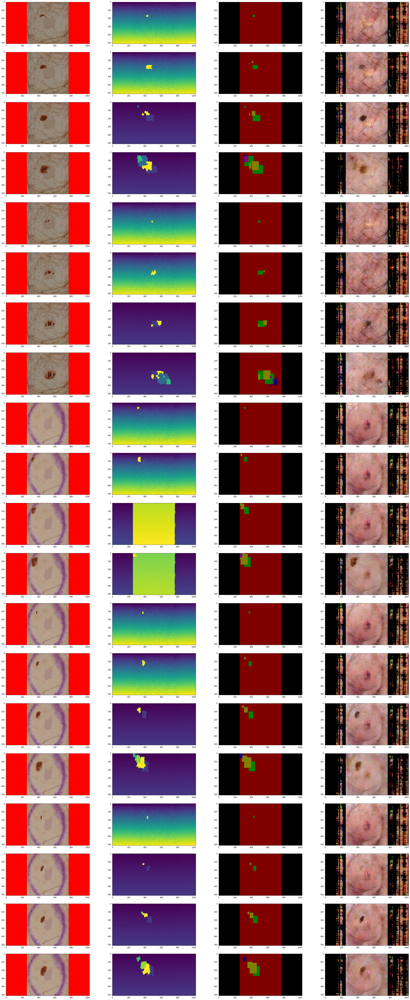

In [10]:
generated_path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/pix2pix_result_boxed_with_inst/label2skin/test_latest/images"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")
I_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map")

img_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
i_l = sorted(glob.glob(os.path.join(I_MAP_PATH, "*.png")))
g_l = sorted(glob.glob(os.path.join(generated_path, "*.jpg")))

joined = []
for i in range(len(i_l)):
    p = [img_l[i], i_l[i], g_l[i * 2], g_l[i * 2 + 1]]
    joined.append(p)

cnt = 20
cols = 4
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (40,100))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

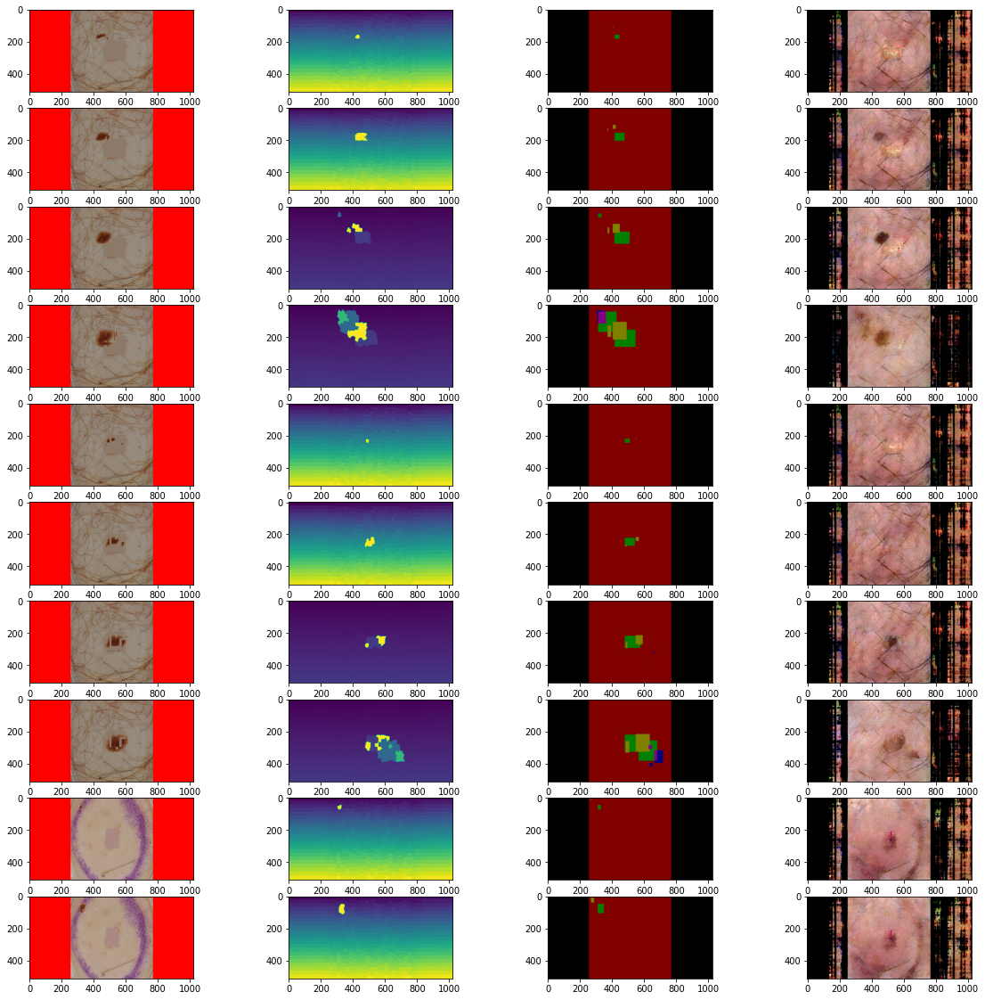

In [11]:
generated_path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/pix2pix_result_boxed_with_inst/label2skin/test_latest/images"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")
I_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map")

img_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
i_l = sorted(glob.glob(os.path.join(I_MAP_PATH, "*.png")))
g_l = sorted(glob.glob(os.path.join(generated_path, "*.jpg")))

joined = []
for i in range(len(i_l)):
    p = [img_l[i], i_l[i], g_l[i * 2], g_l[i * 2 + 1]]
    joined.append(p)

cnt = 10
cols = 4
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (20,20))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

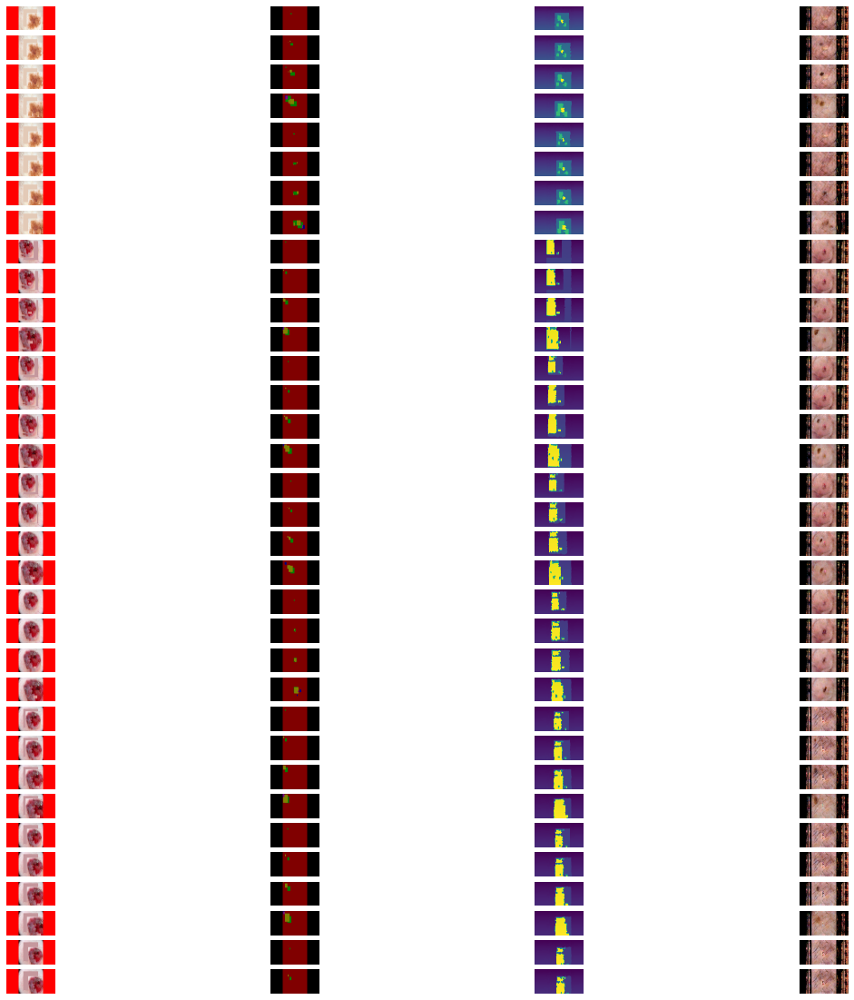

In [110]:
generated_path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/pix2pix_result_boxed_with_inst/label2skin/test_latest/images"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")
I_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "instance_map")

img_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
i_l = sorted(glob.glob(os.path.join(I_MAP_PATH, "*.png")))
g_l = sorted(glob.glob(os.path.join(generated_path, "*.jpg")))

joined = []
for i in range(len(i_l)):
    p = [img_l[i], g_l[i * 2], i_l[i],  g_l[i * 2 + 1]]
    joined.append(p)

cnt = 34
cols = 4
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (20,20))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

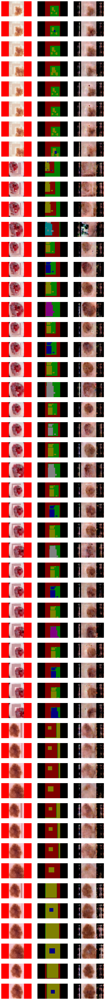

In [35]:


BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/pix2pix"

SEGMENTATION_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "segmentation_resized")
ATTRIBUTES_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "attribute_resized")
IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "image_resized")
SEMANTIC_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "semantic_map")




generated_path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/p2p_normalized_with_inst/label2skin/test_latest/images"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")

img_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
g_l = sorted(glob.glob(os.path.join(generated_path, "*.jpg")))

joined = []

for i in range(len(i_l)):
    p = [img_l[i], g_l[i * 2], g_l[i * 2 + 1]]
    joined.append(p)

cnt = 50
cols = 3
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (10,100))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
        plots[i][j].axis('off')
plt.show()

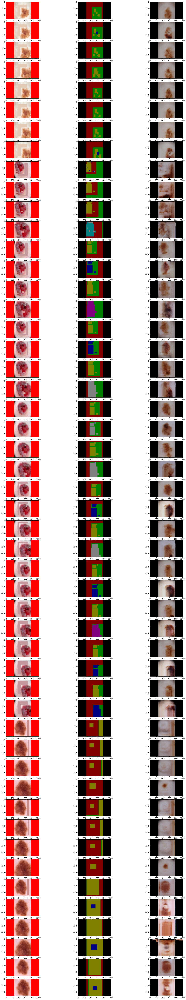

In [10]:


BASE_RESIZED_PATH = "/mnt/tank/scratch/nduginets/images/noise_bboxes_v2/pix2pix"

SEGMENTATION_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "segmentation_resized")
ATTRIBUTES_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "attribute_resized")
IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "image_resized")
SEMANTIC_MAP_PATH = os.path.join(BASE_RESIZED_PATH, "semantic_map")




generated_path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/p2p_normalized_no_inst/l2s_bb_no_inst/test_latest/images"

IMAGE_RESIZED_PATH = os.path.join(BASE_RESIZED_PATH, "images_512p")

img_l = sorted(glob.glob(os.path.join(IMAGE_RESIZED_PATH, "*.png")))
g_l = sorted(glob.glob(os.path.join(generated_path, "*.jpg")))

joined = []

for i in range(len(i_l)):
    p = [img_l[i], g_l[i * 2], g_l[i * 2 + 1]]
    joined.append(p)

cnt = 50
cols = 3
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (20,100))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

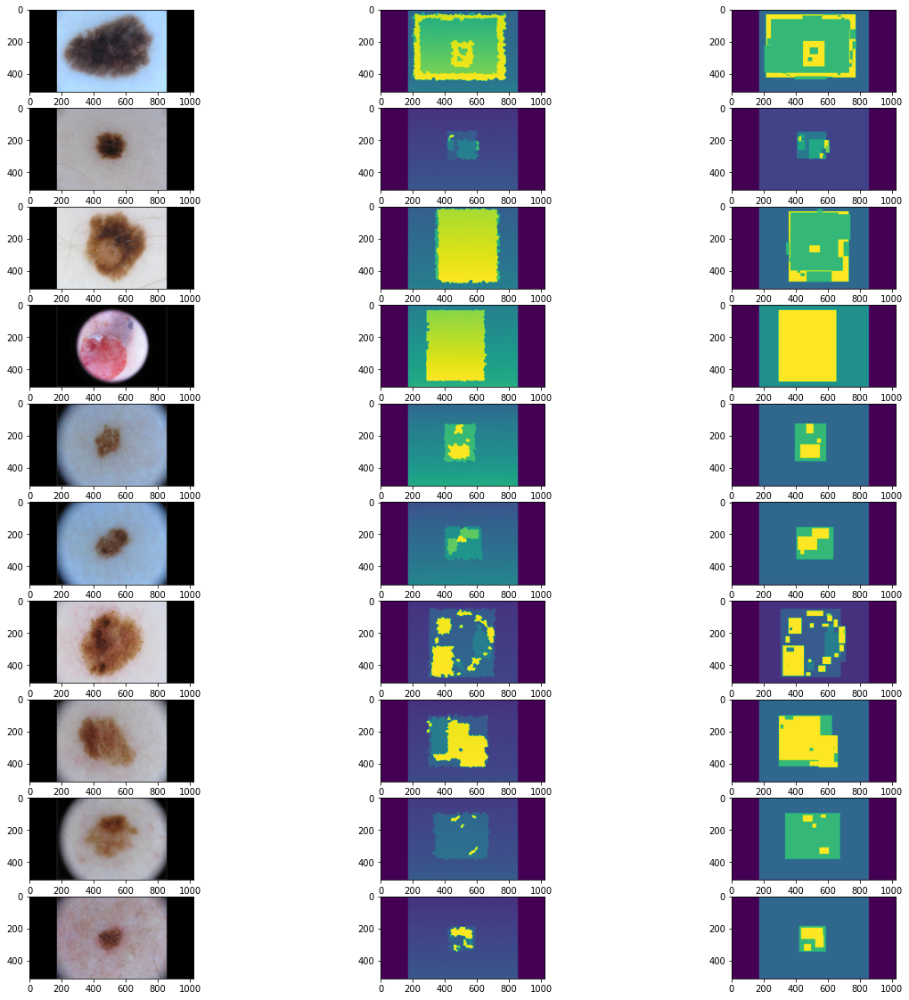

In [12]:
path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_datasets"

a = os.path.join(path, "train_img")
b = os.path.join(path, "train_inst")
c = os.path.join(path, "train_label")

a_l = sorted(glob.glob(os.path.join(a, "*.png")))
b_l = sorted(glob.glob(os.path.join(b, "*.png")))
c_l = sorted(glob.glob(os.path.join(c, "*.png")))


joined = []
for i in range(len(a_l)):
    p = [a_l[i], b_l[i], c_l[i]]
    joined.append(p)

cnt = 10
cols = len(joined[0])
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (20,20))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

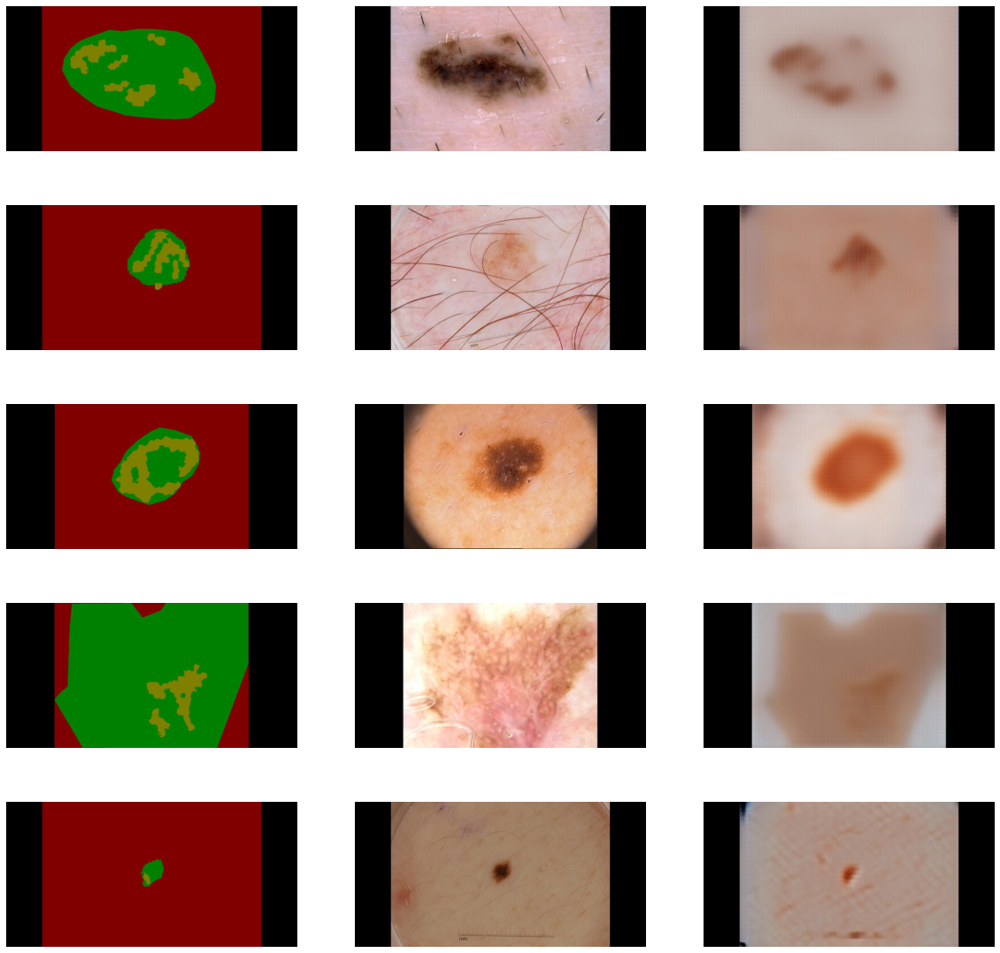

In [30]:
p = "/mnt/tank/scratch/nduginets/images/pix2pix_checkpoints/checkpoints/label2skin/web/images"

a = sorted(glob.glob(os.path.join(p, "*.jpg")))

a1 = a[::3]
a2 = a[1::3]
a3 = a[2::3]

assert len(a1) == len(a2) and len(a2) == len(a3)

idx = [1, 50, 100, 150, 190]

data = list(zip(a1, a2, a3))

data
fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (20,20))
for i, pos in enumerate(idx):
    for j in range(3):
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(data[i][j]))
plt.show()

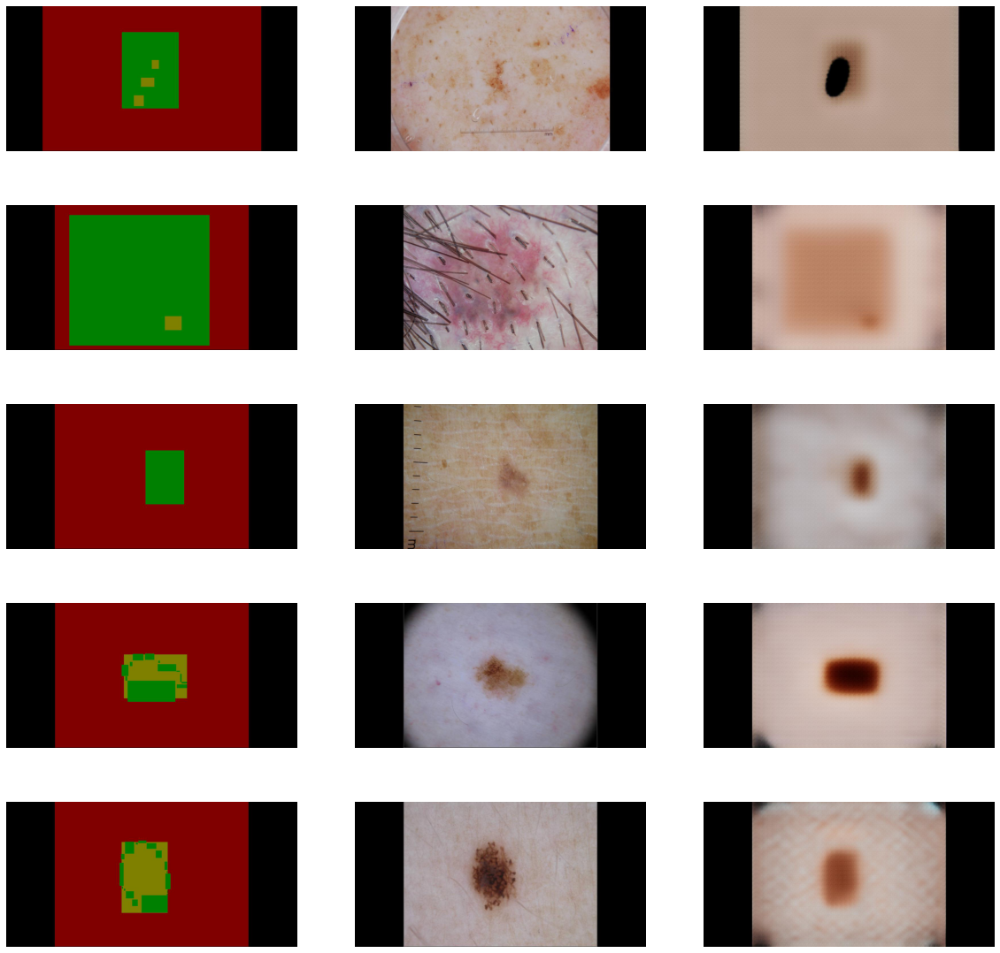

In [32]:
p = "/mnt/tank/scratch/nduginets/images/pix2pix_checkpoints/boxed_checkpoints/label2skin/web/images"

a = sorted(glob.glob(os.path.join(p, "*.jpg")))

a1 = a[::3]
a2 = a[1::3]
a3 = a[2::3]

assert len(a1) == len(a2) and len(a2) == len(a3)

idx = [1, 50, 100, 150, 199]

data = list(zip(a1, a2, a3))

data
fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (20,20))
for i, pos in enumerate(idx):
    for j in range(3):
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(data[i][j]))
plt.show()

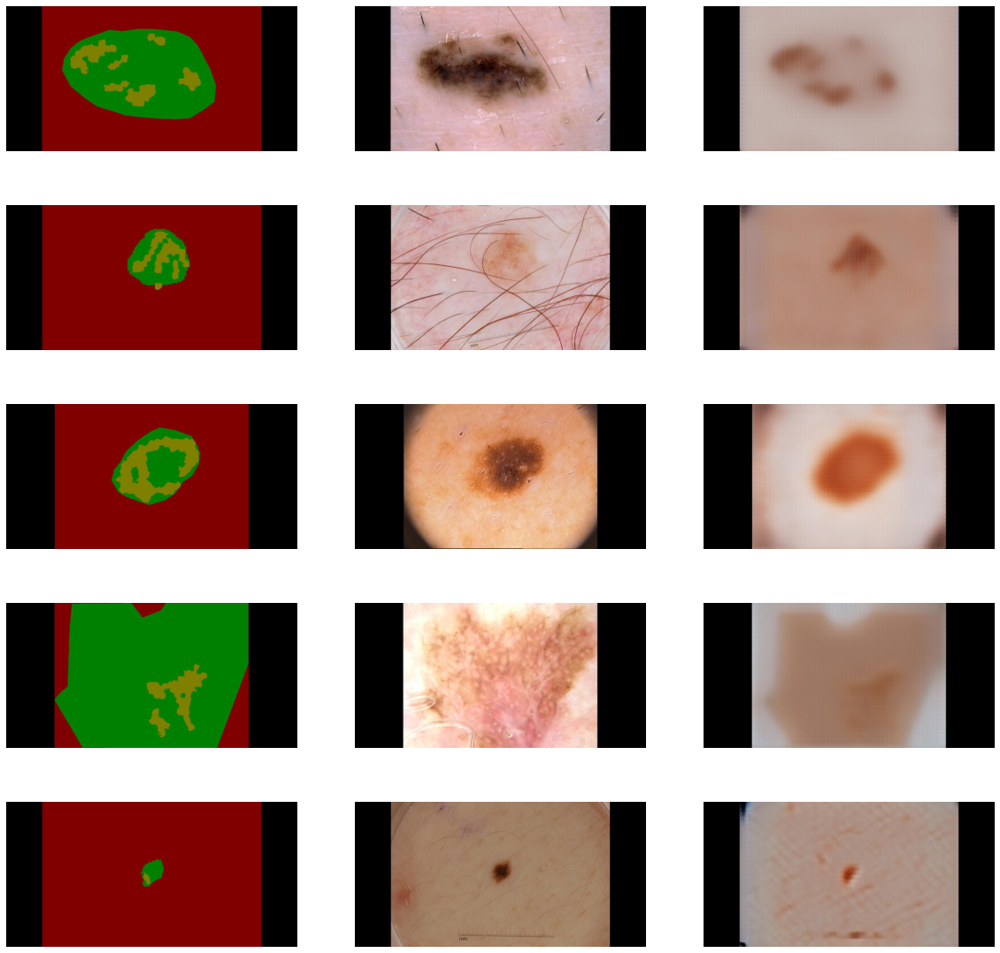

In [36]:
p = "/mnt/tank/scratch/nduginets/images/pix2pix_checkpoints/checkpoints/label2skin/web/images"

a = sorted(glob.glob(os.path.join(p, "*.jpg")))

a1 = a[::3]
a2 = a[1::3]
a3 = a[2::3]

assert len(a1) == len(a2) and len(a2) == len(a3)

idx = [1, 50, 100, 150, 190]

data = list(zip(a1, a2, a3))

data
fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (20,20))
for i, pos in enumerate(idx):
    for j in range(3):
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(data[i][j]))
plt.show()

In [53]:
for i, p in enumerate([3,5,7]):
    print(i, p)

0 3
1 5
2 7


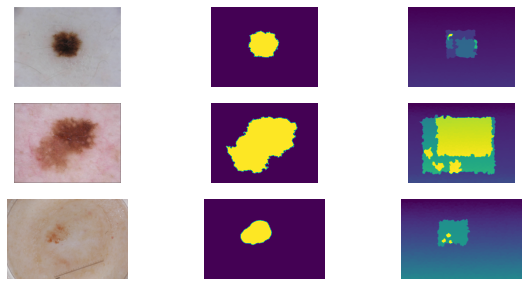

In [67]:
b = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/base_dataset_folder/"

im = sorted(glob.glob(os.path.join(b + "images_512p/*.png")))
s = sorted(glob.glob(os.path.join(b + "seg_512p/*.png")))
ins = sorted(glob.glob(os.path.join(b + "instance_map_no_border/*.png")))

assert len(im) == len(s) and len(ins)

idx = [1, 47, 1488]

data = list(zip(im, s, idx))

data
fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (10,5))
for pos, i in enumerate(idx):
    for j in range(3):
        plots[pos][j].axis('off')
    plots[pos][0].imshow(mpimg.imread(im[i]))
    plots[pos][1].imshow(mpimg.imread(s[i]))
    plots[pos][2].imshow(mpimg.imread(ins[i]))
plt.show()

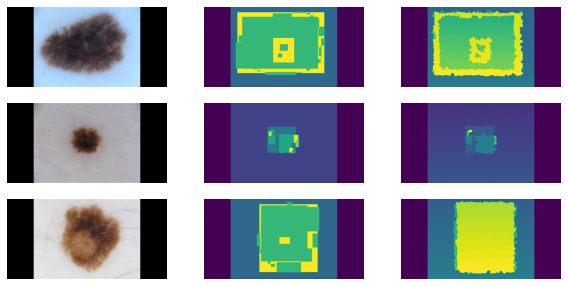

In [66]:
path = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/bb_datasets"

a = os.path.join(path, "train_img")
b = os.path.join(path, "train_label")
c = os.path.join(path, "train_inst")

a_l = sorted(glob.glob(os.path.join(a, "*.png")))
b_l = sorted(glob.glob(os.path.join(b, "*.png")))
c_l = sorted(glob.glob(os.path.join(c, "*.png")))


joined = []
for i in range(len(a_l)):
    p = [a_l[i], b_l[i], c_l[i]]
    joined.append(p)

cnt = 3
cols = len(joined[0])
fig, plots = plt.subplots(nrows=cnt, ncols=cols, figsize = (10,5))
for i in range(cnt):
    for j in range(cols):
        plots[i][j].axis('off')
        plots[i][j].imshow(mpimg.imread(joined[i][j]))
plt.show()

In [80]:
def change_angle_to_radius_unit(angle):
    angle_radius = angle * (np.pi/180)
    return angle_radius

def rotate(src_img,angle_of_rotation,pivot_point,shape_img):

    #1.create rotation matrix with numpy array
    rotation_mat = np.transpose(np.array([[np.cos(angle_of_rotation),-np.sin(angle_of_rotation)],
                            [np.sin(angle_of_rotation),np.cos(angle_of_rotation)]]))
    h,w = shape_img
    
    pivot_point_x =  pivot_point[0]
    pivot_point_y = pivot_point[1]
    
    new_img = np.zeros(src_img.shape,dtype='u1') 

    for height in range(h): #h = number of row
        for width in range(w): #w = number of col
            xy_mat = np.array([[width-pivot_point_x],[height-pivot_point_y]])
            
            rotate_mat = np.dot(rotation_mat,xy_mat)

            new_x = pivot_point_x + int(rotate_mat[0])
            new_y = pivot_point_y + int(rotate_mat[1])


            if (0<=new_x<=w-1) and (0<=new_y<=h-1): 
                new_img[new_y,new_x] = src_img[height,width]

    return new_img



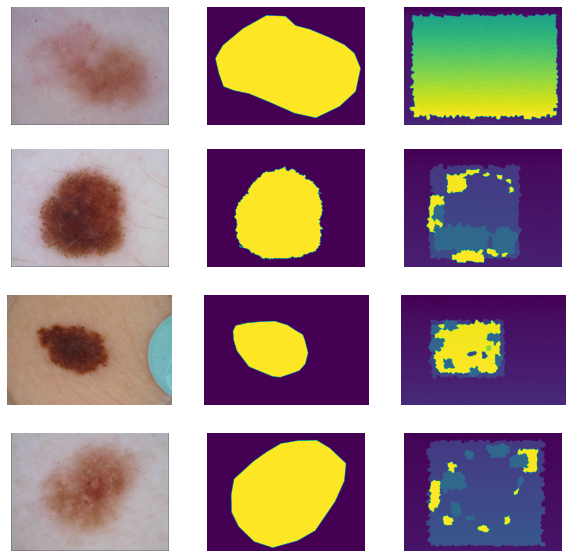

In [106]:
b = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/base_dataset_folder/"

im = sorted(glob.glob(os.path.join(b + "images_512p/*.png")))
s = sorted(glob.glob(os.path.join(b + "seg_512p/*.png")))
ins = sorted(glob.glob(os.path.join(b + "instance_map_no_border/*.png")))

assert len(im) == len(s) and len(ins)

idx = [23, 60, 549, 54]

data = list(zip(im, s, idx))

data
fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (10,10))
for pos, i in enumerate(idx):
    for j in range(3):
        plots[pos][j].axis('off')
    plots[pos][0].imshow(mpimg.imread(im[i]))
    plots[pos][1].imshow(mpimg.imread(s[i]))
    plots[pos][2].imshow(mpimg.imread(ins[i]))
plt.show()

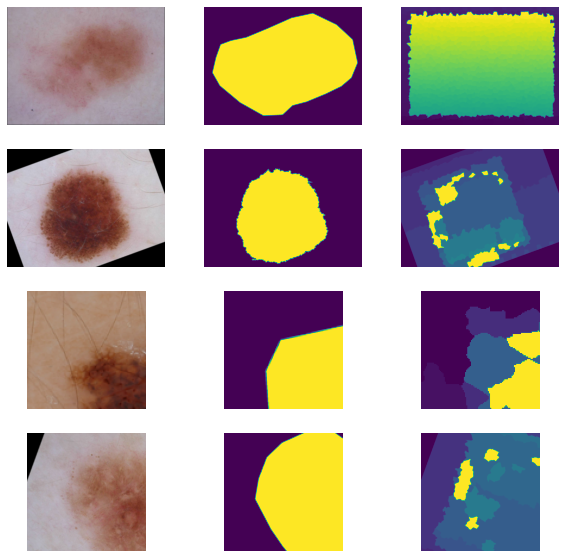

In [107]:
b = "/mnt/tank/scratch/nduginets/images/pix2pix_datasets/base_dataset_folder/"

im = sorted(glob.glob(os.path.join(b + "images_512p/*.png")))
s = sorted(glob.glob(os.path.join(b + "seg_512p/*.png")))
ins = sorted(glob.glob(os.path.join(b + "instance_map_no_border/*.png")))

assert len(im) == len(s) and len(ins)

idx = [23, 60, 549, 54]

data = list(zip(im, s, idx))

def apply(index, array):
    plots[0][index].imshow(np.flip(mpimg.imread(array[idx[0]]), axis=0))
    plots[1][index].imshow(Image.fromarray(np.uint8(mpimg.imread(array[idx[1]])*255)).rotate(20))
    plots[2][index].imshow(Image.fromarray(np.uint8(mpimg.imread(array[idx[2]])*255)).crop((100, 100, 200, 200)))
    plots[3][index].imshow(Image.fromarray(np.uint8(np.flip(mpimg.imread(array[idx[3]])*255, axis=0))).rotate(-20).crop((10, 10, 400, 400)))


fig, plots = plt.subplots(nrows=len(idx), ncols=3, figsize = (10,10))
for pos, i in enumerate(idx):
    for j in range(3):
        plots[pos][j].axis('off')

apply(0, im)
apply(1, s)
apply(2, ins)




plt.show()
